# Facemask carrying detection
Task of this project is to train a deep learning model that is able to solve an object detection problem. The specific problem solved in this notebook is "Facemask carrying detection" problem, where the deep learning model needs to detect if people are wearing masks or not. <br>

Dataset used for this purpose has images belonging to three classes - no mask, mask and mask worn incorrectly.

**Objective:** <br>
Identifying whether a person is wearing a face mask or not, and whether they are wearing it correctly.

# YOLO model
In this notebook, YOLOv5 model is used for training.

YOLO algorithm employs convolutional neural networks (CNN) to detect objects in real-time, and is an acronym for “You Only Look Once”. As the name suggests, the algorithm requires only a single forward propagation through a neural network to detect objects. [1] <br>

YOLO algorithm aims to predict a class of an object and the bounding box that defines the object location on the input image. In addition to that, YOLO predicts the corresponding number c for the predicted class as well as the probability of the prediction. [2]


# Setup the Environment

In [1]:
# Import required libraries
import pandas as pd
import numpy as np
import os
import random
import glob
from datetime import datetime
import xml.etree.ElementTree as ET 
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
import yaml
import shutil
import warnings
warnings.filterwarnings('ignore')

In [2]:
# shutil.rmtree("/kaggle/working/yolov5")

In [3]:
# Cloning and installing YOLO from github repository.
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
!pip install -qr requirements.txt

Cloning into 'yolov5'...
remote: Enumerating objects: 14927, done.
remote: Counting objects: 100% (19/19), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 14927 (delta 7), reused 12 (delta 2), pack-reused 14908
Receiving objects: 100% (14927/14927), 13.95 MiB | 27.46 MiB/s, done.
Resolving deltas: 100% (10251/10251), done.
/kaggle/working/yolov5


In [4]:
# Loading the data 
input_data = '/kaggle/input/face-mask-detection'
output_data = '/kaggle/working'

# Read and Handle Annotations

In [5]:
# Reading annotations path of input images
annotations_path = "/kaggle/input/face-mask-detection/annotations"
images_path = "/kaggle/input/face-mask-detection/images"

In [6]:
# Read the data from .xml files using annotations and extract filename and dimensions of the bounding boxes
dataset = {
            "file":[],
            "name":[],    
            "width":[],
            "height":[],
            "xmin":[],
            "ymin":[],   
            "xmax":[],
            "ymax":[],
           }

for anno in glob.glob(annotations_path+"/*.xml"):
    tree = ET.parse(anno)
    
    for elem in tree.iter():
        if 'size' in elem.tag:
            for attr in list(elem):
                if 'width' in attr.tag: 
                    width = int(round(float(attr.text)))
                if 'height' in attr.tag:
                    height = int(round(float(attr.text)))    

        if 'object' in elem.tag:
            for attr in list(elem):
                
                if 'name' in attr.tag:
                    name = attr.text                 
                    dataset['name']+=[name]
                    dataset['width']+=[width]
                    dataset['height']+=[height] 
                    dataset['file']+=[anno.split('/')[-1][0:-4]] 
                            
                if 'bndbox' in attr.tag:
                    for dim in list(attr):
                        if 'xmin' in dim.tag:
                            xmin = int(round(float(dim.text)))
                            dataset['xmin']+=[xmin]
                        if 'ymin' in dim.tag:
                            ymin = int(round(float(dim.text)))
                            dataset['ymin']+=[ymin]                                
                        if 'xmax' in dim.tag:
                            xmax = int(round(float(dim.text)))
                            dataset['xmax']+=[xmax]                                
                        if 'ymax' in dim.tag:
                            ymax = int(round(float(dim.text)))
                            dataset['ymax']+=[ymax]

In [7]:
# Import data from previous step into a pandas dataframe
df=pd.DataFrame(dataset)
df.head(10)

,file,name,width,height,xmin,ymin,xmax,ymax
0,maksssksksss737,with_mask,400,226,28,55,46,71
1,maksssksksss737,with_mask,400,226,98,62,111,78
2,maksssksksss737,mask_weared_incorrect,400,226,159,50,193,90
3,maksssksksss737,with_mask,400,226,293,59,313,80
4,maksssksksss737,with_mask,400,226,352,51,372,72
5,maksssksksss737,with_mask,400,226,228,53,241,73
6,maksssksksss410,with_mask,400,267,34,153,62,176
7,maksssksksss410,with_mask,400,267,88,138,111,163
8,maksssksksss410,with_mask,400,267,139,207,168,234
9,maksssksksss410,with_mask,400,267,116,135,135,154


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4072 entries, 0 to 4071
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   file    4072 non-null   object
 1   name    4072 non-null   object
 2   width   4072 non-null   int64 
 3   height  4072 non-null   int64 
 4   xmin    4072 non-null   int64 
 5   ymin    4072 non-null   int64 
 6   xmax    4072 non-null   int64 
 7   ymax    4072 non-null   int64 
dtypes: int64(6), object(2)
memory usage: 254.6+ KB


In [9]:
name_dict = {
    'with_mask': 0,
    'mask_weared_incorrect': 1,
    'without_mask': 2 
}

df['class'] = df['name'].map(name_dict)

In [10]:
np.sort(df.name.unique())

array(['mask_weared_incorrect', 'with_mask', 'without_mask'], dtype=object)

In [11]:
# Descriptive statistics
pd.options.display.max_columns = 13
pd.DataFrame(df.describe(include='all').round(2))

,file,name,width,height,xmin,ymin,xmax,ymax,class
count,4072,4072,4072.00,4072.00,4072.00,4072.00,4072.00,4072.00,4072.00
unique,853,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,maksssksksss603,with_mask,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,115,3232,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,393.70,270.12,182.21,85.78,213.36,120.79,0.38
std,NaN,NaN,35.41,52.34,104.47,52.57,102.71,70.36,0.77
min,NaN,NaN,193.00,156.00,1.00,1.00,8.00,6.00,0.00
25%,NaN,NaN,400.00,226.00,96.00,49.00,134.00,73.00,0.00
50%,NaN,NaN,400.00,267.00,177.00,75.00,212.00,103.00,0.00
75%,NaN,NaN,400.00,281.00,266.00,113.00,292.00,148.00,0.00


In [12]:
# Number of images in each class
labels = df.name.unique()
labels_list = [df['name'].value_counts()["with_mask"], df['name'].value_counts()["mask_weared_incorrect"], df['name'].value_counts()["without_mask"]]
print(labels_list)
print(labels)

[3232, 123, 717]
['with_mask' 'mask_weared_incorrect' 'without_mask']


# Graph the train data statistics

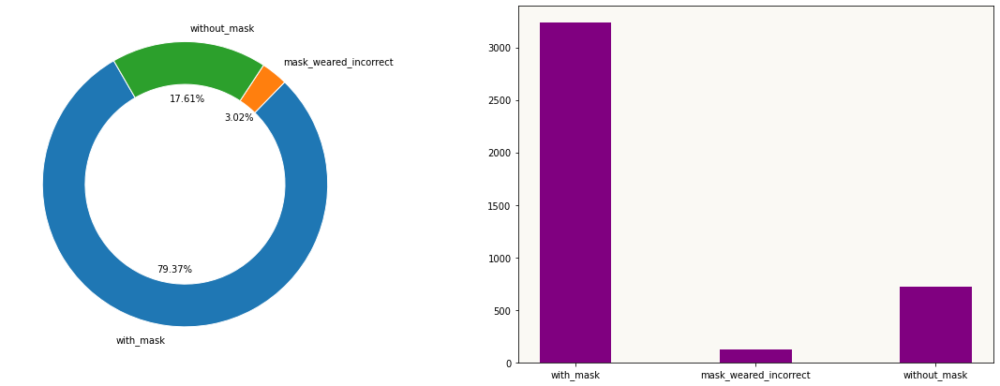

In [13]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize =(20,7))
background_color = '#faf9f4'
ax1.set_facecolor(background_color)
ax2.set_facecolor(background_color) 
ax1.pie(labels_list, wedgeprops=dict(width=0.3, edgecolor='w'),
        labels=labels, radius=1, startangle=120, autopct='%1.2f%%')

ax2 = plt.bar(labels, list(labels_list),
              color ='purple',width = 0.4)

plt.show()

# Train Test Split

In [14]:
fileNames = [*os.listdir("/kaggle/input/face-mask-detection/images")]
print('There are {} images in the dataset'.format(len(fileNames)))

There are 853 images in the dataset


In [15]:
# Splitting the dataset into training, testing and validation set
from sklearn.model_selection import train_test_split
train, test = train_test_split(fileNames, test_size=0.1, random_state=22)
test, val = train_test_split(test, test_size=0.7, random_state=22)
print("Length of Train =",len(train))
print("="*30)
print("Length of Valid =",len(val))
print("="*30)
print("Length of Test =", len(test))

Length of Train = 767
Length of Valid = 61
Length of Test = 25


# Graph Train Test Split

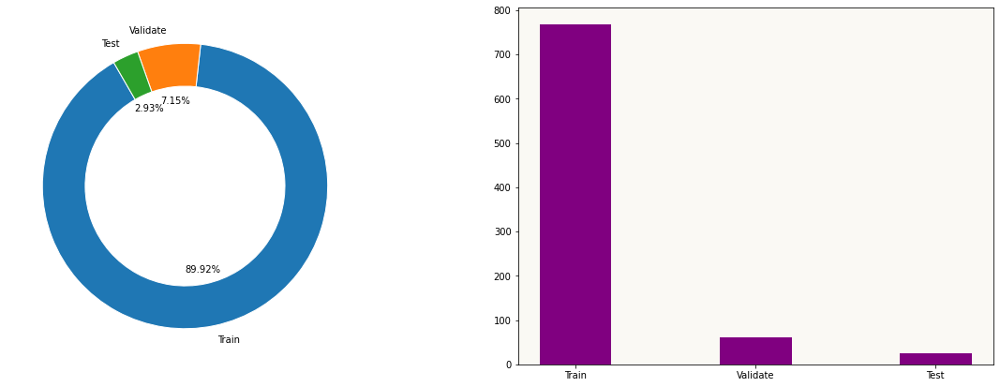

In [16]:
data = [len(train), len(val), len(test)]
labels = ['Train', 'Validate', 'Test']

fig, (ax1, ax2) = plt.subplots(1, 2, figsize =(20,7))
background_color = '#faf9f4'
ax1.set_facecolor(background_color)
ax2.set_facecolor(background_color) 
ax1.pie(data, wedgeprops=dict(width=0.3, edgecolor='w'),
        labels=labels, radius=1, startangle=120, autopct='%1.2f%%')

ax2 = plt.bar(labels, list(data),
              color ='purple',width = 0.4)

plt.show()

# Normalizing and sorting data

In [17]:
# Create separate train,test and validation directory inside yolov5/data/
os.chdir('/kaggle/working/')
os.mkdir('./yolov5/data/train')
os.mkdir('./yolov5/data/val')
os.mkdir('./yolov5/data/test')
os.mkdir('./yolov5/data/train/images')
os.mkdir('./yolov5/data/train/labels')
os.mkdir('./yolov5/data/test/images')
os.mkdir('./yolov5/data/test/labels')
os.mkdir('./yolov5/data/val/images')
os.mkdir('./yolov5/data/val/labels')

In [18]:
# Normalizing data and sort images in appropriate directories 
from PIL import Image

def copyImages(imageList, folder_Name):
    for image in imageList:
        img = Image.open(input_data+"/images/"+image)
        img1 = img.resize((640, 480))
        _ = img1.save(output_data+"/yolov5/data/"+folder_Name+"/images/"+image)

copyImages(train, "train")
copyImages(val, "val")
copyImages(test, "test")

In [19]:
df.head(10)

,file,name,width,height,xmin,ymin,xmax,ymax,class
0,maksssksksss737,with_mask,400,226,28,55,46,71,0
1,maksssksksss737,with_mask,400,226,98,62,111,78,0
2,maksssksksss737,mask_weared_incorrect,400,226,159,50,193,90,1
3,maksssksksss737,with_mask,400,226,293,59,313,80,0
4,maksssksksss737,with_mask,400,226,352,51,372,72,0
5,maksssksksss737,with_mask,400,226,228,53,241,73,0
6,maksssksksss410,with_mask,400,267,34,153,62,176,0
7,maksssksksss410,with_mask,400,267,88,138,111,163,0
8,maksssksksss410,with_mask,400,267,139,207,168,234,0
9,maksssksksss410,with_mask,400,267,116,135,135,154,0


In [20]:
# Update bounding box dimensions because images were resized

df['xmax'] = (640/df['width'])*df['xmax']
df['ymax'] = (480/df['height'])*df['ymax']
df['xmin'] = (640/df['width'])*df['xmin']
df['ymin'] = (480/df['height'])*df['ymin']

In [21]:
df[['xmax', 'ymax', 'xmin', 'ymin']] = df[['xmax', 'ymax', 'xmin', 'ymin']].astype('int64')

In [22]:
df['x_center'] = (df['xmax']+df['xmin'])/(2*640)
df['y_center'] = (df['ymax']+df['ymin'])/(2*480)
df['box_height'] = (df['xmax']-df['xmin'])/(640)
df['box_width'] = (df['ymax']-df['ymin'])/(480)

In [23]:
df.head()

,file,name,width,height,xmin,ymin,xmax,ymax,class,x_center,y_center,box_height,box_width
0,maksssksksss737,with_mask,400,226,44,116,73,150,0,0.091406,0.277083,0.045312,0.070833
1,maksssksksss737,with_mask,400,226,156,131,177,165,0,0.260156,0.308333,0.032813,0.070833
2,maksssksksss737,mask_weared_incorrect,400,226,254,106,308,191,1,0.439063,0.309375,0.084375,0.177083
3,maksssksksss737,with_mask,400,226,468,125,500,169,0,0.756250,0.306250,0.050000,0.091667
4,maksssksksss737,with_mask,400,226,563,108,595,152,0,0.904687,0.270833,0.050000,0.091667


In [24]:
df = df.astype('string')

In [25]:
# Add labels of images to appropriate directories
def create_labels(image_list, data_name):
    fileNames = [x.split(".")[0] for x in image_list]

    for name in fileNames:
        data = df[df.file==name]
        box_list = []
        
        for index in range(len(data)):
            row = data.iloc[index]
            box_list.append(row['class']+" "+row["x_center"]+" "+row["y_center"]\
                        +" "+row["box_height"]+" "+row["box_width"])
            
        text = "\n".join(box_list)
        with open(output_data+"/yolov5/data/"+data_name+"/labels/"+name+".txt", "w") as file:
            file.write(text)


create_labels(train, "train")
create_labels(val, "val")
create_labels(test, "test")

# Configure the Model

In [26]:
# Positioning inside YOLO directory to display images
%cd yolov5
from IPython.display import Image, clear_output
import torch
from yolov5 import utils
display = utils.notebook_init()

YOLOv5 🚀 v7.0-56-gc0ca1d2 Python-3.7.12 torch-1.11.0 CUDA:0 (Tesla T4, 15110MiB)


Setup complete ✅ (2 CPUs, 15.6 GB RAM, 4048.3/8062.4 GB disk)


In [27]:
# Configure .yaml file to guide the model for training
yaml_text = """train: data/train/images
val: data/train/images

nc: 3
names: ['with_mask', 'mask_weared_incorrect', 'without_mask']"""

with open("data/data.yaml", 'w') as file:
    file.write(yaml_text)

%cat data/data.yaml

train: data/train/images
val: data/train/images

nc: 3
names: ['with_mask', 'mask_weared_incorrect', 'without_mask']

In [28]:
# Customize iPython writefile for writing variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [29]:
%%writetemplate models/custom_yolov5s.yaml

# parameters
nc: 3  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
    - [10,13, 16,30, 33,23]  # P3/8
    - [30,61, 62,45, 59,119]  # P4/16
    - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
    [[-1, 1, Conv, [512, 1, 1]],
    [-1, 1, nn.Upsample, [None, 2, 'nearest']],
    [[-1, 6], 1, Concat, [1]],  # cat backbone P4
    [-1, 3, BottleneckCSP, [512, False]],  # 13

    [-1, 1, Conv, [256, 1, 1]],
    [-1, 1, nn.Upsample, [None, 2, 'nearest']],
    [[-1, 4], 1, Concat, [1]],  # cat backbone P3
    [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

    [-1, 1, Conv, [256, 3, 2]],
    [[-1, 14], 1, Concat, [1]],  # cat head P4
    [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

    [-1, 1, Conv, [512, 3, 2]],
    [[-1, 10], 1, Concat, [1]],  # cat head P5
    [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

    [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
    ]

# Training the network

In [30]:
# Using pre-trained weights from yolov5.pt model

start = datetime.now()
!python train.py --img 640 --batch 32 --epochs 50 --data data/data.yaml --cfg models/custom_yolov5s.yaml --weights yolov5s.pt --name yolov5s_results  --cache
end = datetime.now()

wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visualize my results
wandb: Enter your choice: (30 second timeout) 
wandb: W&B disabled due to login timeout.
train: weights=yolov5s.pt, cfg=models/custom_yolov5s.yaml, data=data/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5s_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-56-gc0ca1d2 Python-3.7.12 torch-1.11.0 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lr

In [31]:
print("Runtime =",end-start)

Runtime = 0:18:21.912805


# Visualize the training results

In [32]:
results_df = pd.read_csv("/kaggle/working/yolov5/runs/train/yolov5s_results/results.csv")
pd.options.display.max_columns = 20

In [33]:
results_df.head(10)

,epoch,train/box_loss,train/obj_loss,train/cls_loss,metrics/precision,metrics/recall,metrics/mAP_0.5,metrics/mAP_0.5:0.95,val/box_loss,val/obj_loss,val/cls_loss,x/lr0,x/lr1,x/lr2
0,0,0.105810,0.063045,0.035354,0.000768,0.060689,0.000481,0.000123,0.094950,0.054520,0.032923,0.079300,0.002300,0.002300
1,1,0.095918,0.072762,0.029270,0.000646,0.051071,0.000392,0.000105,0.092782,0.055860,0.029372,0.057607,0.004607,0.004607
2,2,0.087761,0.071123,0.023051,0.000568,0.044887,0.000340,0.000082,0.095162,0.054825,0.028687,0.035819,0.006819,0.006819
3,3,0.082065,0.063020,0.019757,0.773070,0.024963,0.023908,0.006848,0.093502,0.048721,0.025269,0.013936,0.008936,0.008936
4,4,0.075940,0.060437,0.018072,0.766440,0.097217,0.058119,0.019917,0.076378,0.052668,0.018286,0.009208,0.009208,0.009208
5,5,0.069296,0.054269,0.017880,0.780490,0.136950,0.108060,0.043765,0.061343,0.049827,0.016602,0.009208,0.009208,0.009208
6,6,0.063603,0.053173,0.016811,0.835990,0.194210,0.191650,0.074771,0.055997,0.043420,0.016208,0.009010,0.009010,0.009010
7,7,0.059681,0.048808,0.016372,0.852490,0.220200,0.287120,0.111320,0.053188,0.039957,0.015218,0.008812,0.008812,0.008812
8,8,0.056713,0.049094,0.015662,0.615320,0.372380,0.341810,0.142550,0.049859,0.037512,0.013982,0.008614,0.008614,0.008614
9,9,0.054956,0.045643,0.014103,0.689420,0.395810,0.369110,0.167650,0.046569,0.033463,0.012973,0.008416,0.008416,0.008416


In [34]:
pd.DataFrame(results_df.describe(include='all').round(2))

,epoch,train/box_loss,train/obj_loss,train/cls_loss,metrics/precision,metrics/recall,metrics/mAP_0.5,metrics/mAP_0.5:0.95,val/box_loss,val/obj_loss,val/cls_loss,x/lr0,x/lr1,x/lr2
count,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00
mean,24.50,0.04,0.04,0.01,0.77,0.49,0.55,0.32,0.04,0.03,0.01,0.01,0.01,0.01
std,14.58,0.02,0.01,0.01,0.23,0.20,0.23,0.16,0.02,0.01,0.01,0.01,0.00,0.00
min,0.00,0.03,0.03,0.00,0.00,0.02,0.00,0.00,0.03,0.02,0.00,0.00,0.00,0.00
25%,12.25,0.03,0.03,0.01,0.67,0.43,0.46,0.22,0.03,0.02,0.00,0.00,0.00,0.00
50%,24.50,0.04,0.04,0.01,0.87,0.53,0.64,0.36,0.03,0.03,0.01,0.01,0.00,0.00
75%,36.75,0.05,0.04,0.01,0.91,0.57,0.71,0.45,0.04,0.03,0.01,0.01,0.01,0.01
max,49.00,0.11,0.07,0.04,0.94,0.76,0.77,0.52,0.10,0.06,0.03,0.08,0.01,0.01


In [35]:
results_df.columns

Index(['               epoch', '      train/box_loss', '      train/obj_loss',
       '      train/cls_loss', '   metrics/precision', '      metrics/recall',
       '     metrics/mAP_0.5', 'metrics/mAP_0.5:0.95', '        val/box_loss',
       '        val/obj_loss', '        val/cls_loss', '               x/lr0',
       '               x/lr1', '               x/lr2'],
      dtype='object')

In [36]:
columns_list = []

for name in results_df.columns:
    if name == '               epoch':
        continue
    else:
        columns_list.append(results_df[name].tolist())

In [37]:
def plot_graphs_yolov5(values, titles, color):
    plt.figure(figsize = (30, 10))

    for i, title in enumerate(titles):
        plt.subplot(1, len(titles), i + 1)
        plt.plot(values[i], linewidth=5, color=color)
        plt.title(title, size=30)

    plt.show()

# Plot the losses for the training data

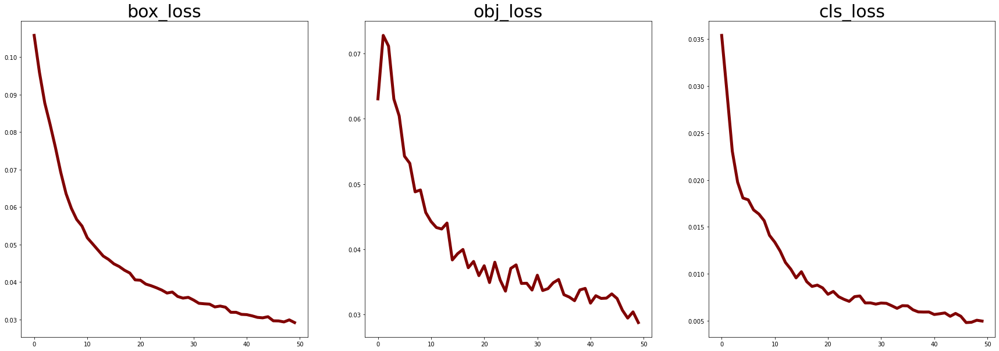

In [38]:
losses = columns_list[:3]

titles = ['box_loss', 'obj_loss', 'cls_loss']

plot_graphs_yolov5(losses, titles, 'maroon')

# Plot the metrics for the *training* data

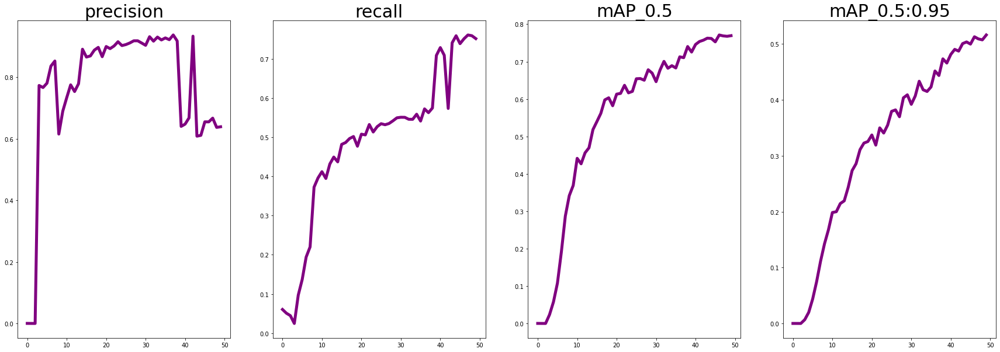

In [39]:
metrics = columns_list[3:7]

titles = ['precision', 'recall', 'mAP_0.5', 'mAP_0.5:0.95']

plot_graphs_yolov5(metrics, titles, 'purple')

# Plot the losses for the *validation* data

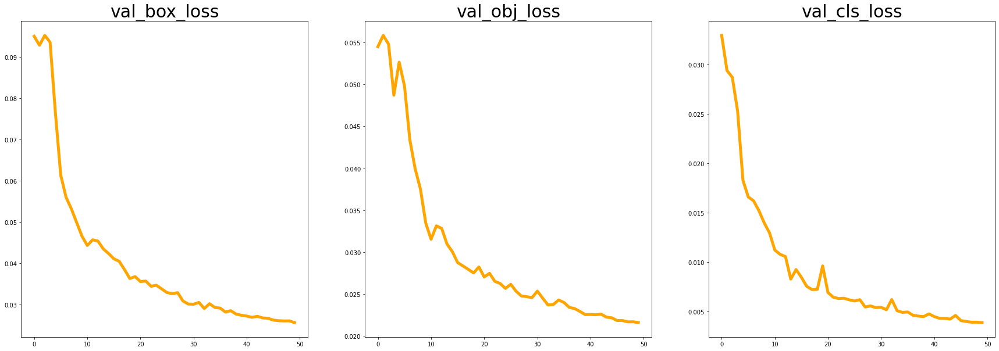

In [40]:
validation = columns_list[7:10]

titles = ['val_box_loss', 'val_obj_loss', 'val_cls_loss']

plot_graphs_yolov5(validation, titles, 'orange')

# Plot the learning rates 

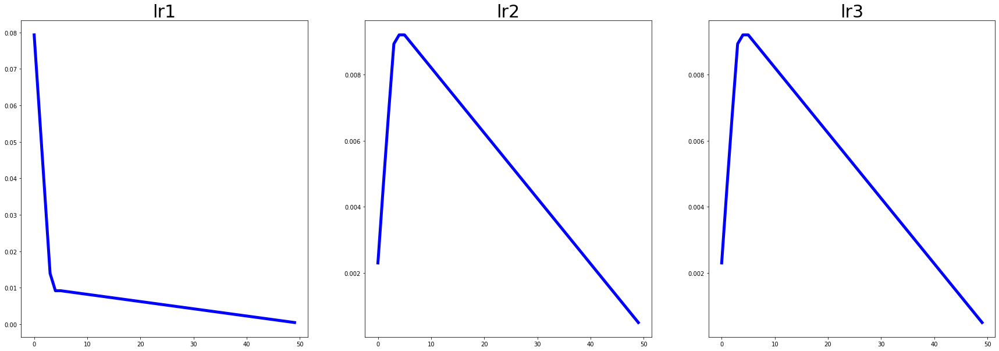

In [41]:
learning_rates = columns_list[10:13]

titles = ['lr1', 'lr2', 'lr3']

plot_graphs_yolov5(learning_rates, titles, 'blue')

# Show the F1-Confidance Curve

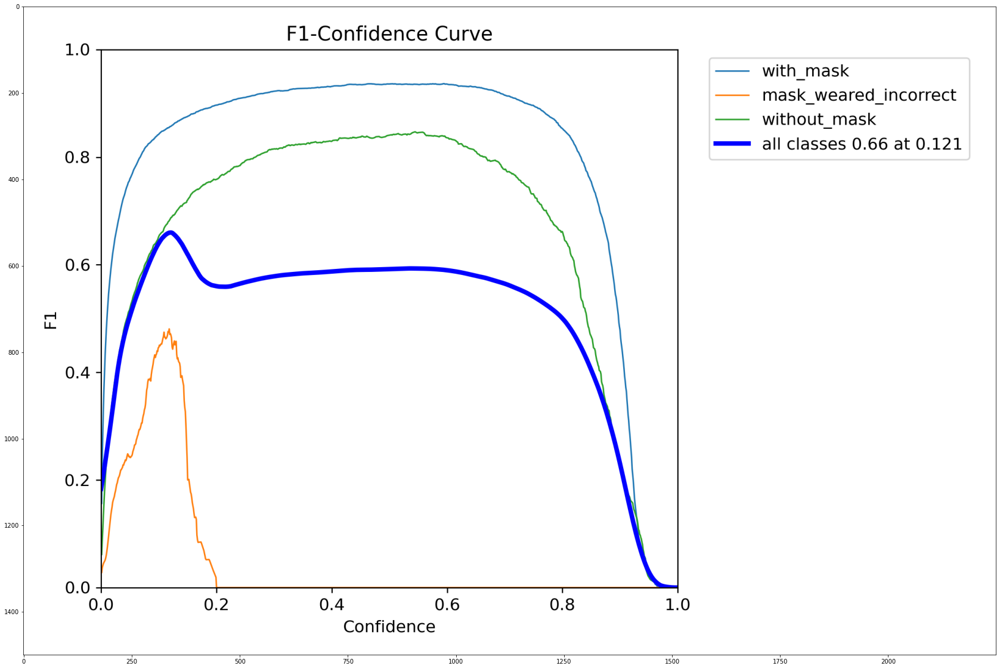

In [42]:
img = plt.imread('/kaggle/working/yolov5/runs/train/yolov5s_results/F1_curve.png')
plt.figure(figsize=(30,20))
plt.imshow(img)
plt.show()

# Show the confusion matrix

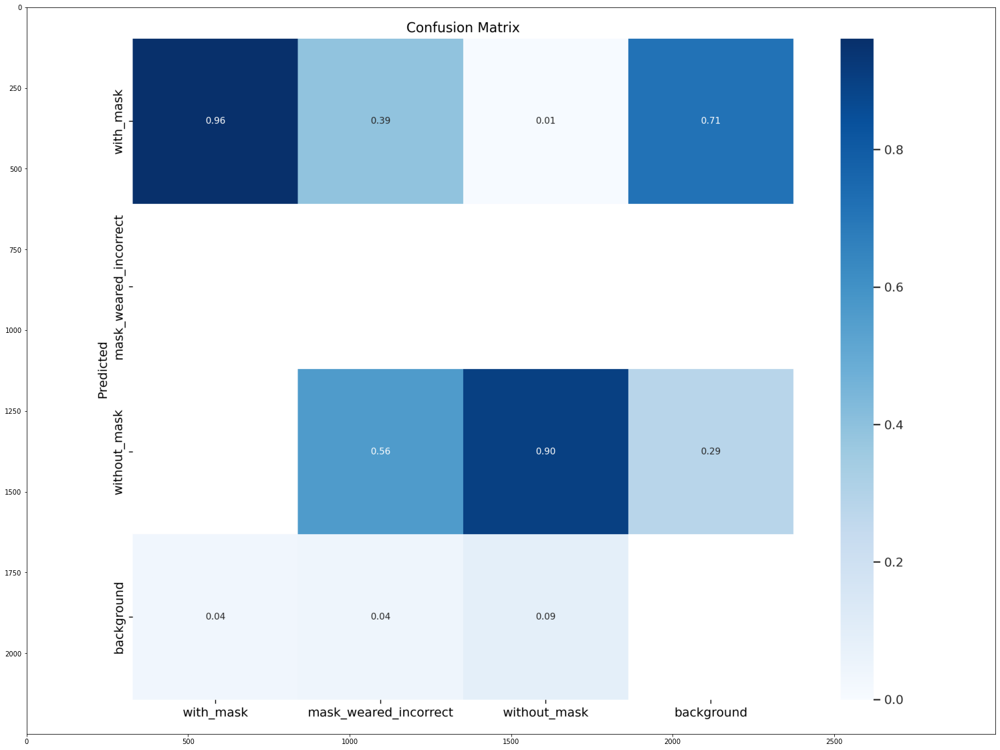

In [43]:
img = plt.imread('/kaggle/working/yolov5/runs/train/yolov5s_results/confusion_matrix.png')
plt.figure(figsize=(30,20))
plt.imshow(img)
plt.show()

# Test the Model
Testing the model over test images seperated before training.

In [44]:
!python detect.py --source data/test/images/ --weight runs/train/yolov5s_results/weights/best.pt --name expTestImage --conf 0.4

detect: weights=['runs/train/yolov5s_results/weights/best.pt'], source=data/test/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=expTestImage, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-56-gc0ca1d2 Python-3.7.12 torch-1.11.0 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7251912 parameters, 0 gradients
image 1/25 /kaggle/working/yolov5/data/test/images/maksssksksss151.png: 480x640 10 with_masks, 22.8ms
image 2/25 /kaggle/working/yolov5/data/test/images/maksssksksss164.png: 480x640 6 with_masks, 4 without_masks, 17.4ms
image 3/25 /kaggle/working/yolov5/data/test/images/maksssksksss173.png: 480x640 2 with_masks, 17.4ms
image 4/25 /kaggle

In [45]:
color_dict = {
    'with_mask': (0, 255, 0),
    'mask_weared_incorrect':  (0, 0, 255),
    'without_mask': (255, 0, 0) 
}

In [46]:
def show_image(img_id):
    df_image = df[df.file==img_id]
    df_image[['xmin', 'ymin', 'xmax', 'ymax']] = df_image[['xmin', 'ymin', 'xmax', 'ymax']].astype('int64')
    path = 'data/test/images/'+img_id# +'.png'
    img = plt.imread(path)

    imge = img.copy()

    for index in range(len(df_image)):
        row = df_image.iloc[index]
        cv2.rectangle(imge, 
                      (row['xmin'], row['ymin']),
                      (row['xmax'], row['ymax']),
                      color=color_dict[row['name']],
                      thickness=2)

    # results are saved inside run/detect/expTestImage dir
    img_pred = plt.imread('runs/detect/expTestImage/'+img_id)
    # ===================================
    plt.figure(figsize=(30,20))

    plt.subplot(1,2,1)
    plt.imshow(imge)
    plt.axis('off')
    plt.title('Test image')

    plt.subplot(1,2,2)
    plt.imshow(img_pred)
    plt.axis('off')
    plt.title('Image with Predicted Box')

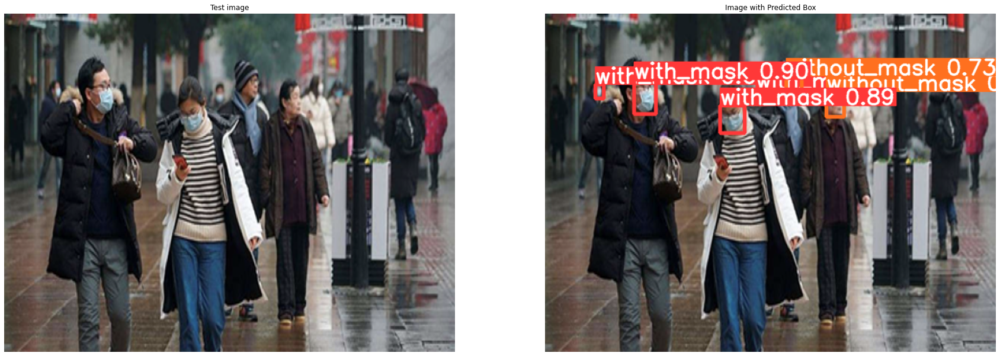

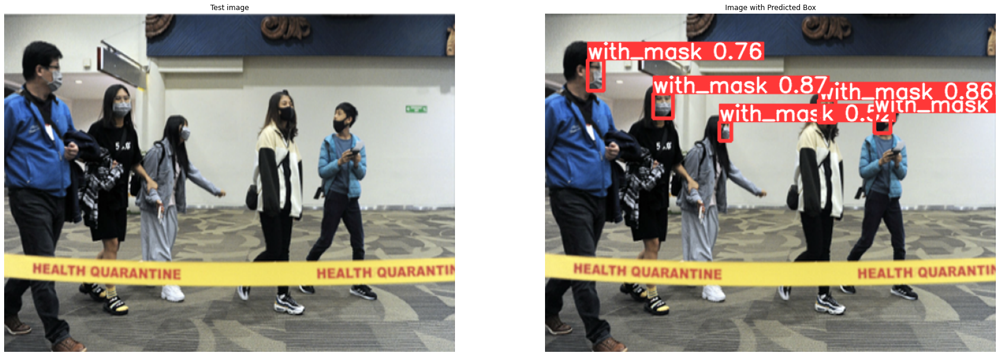

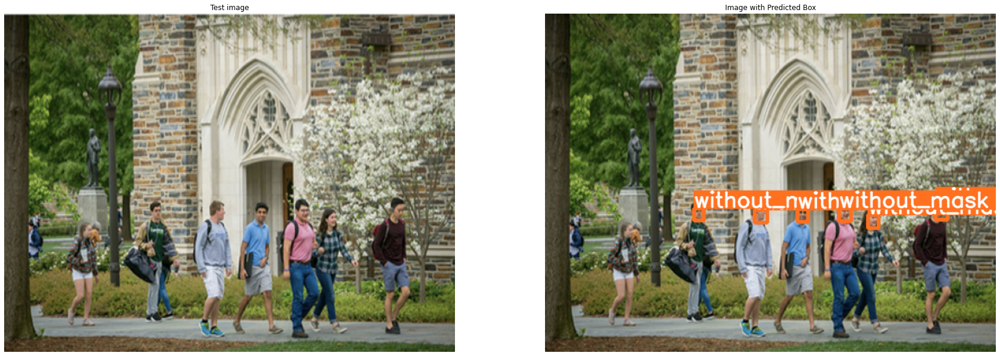

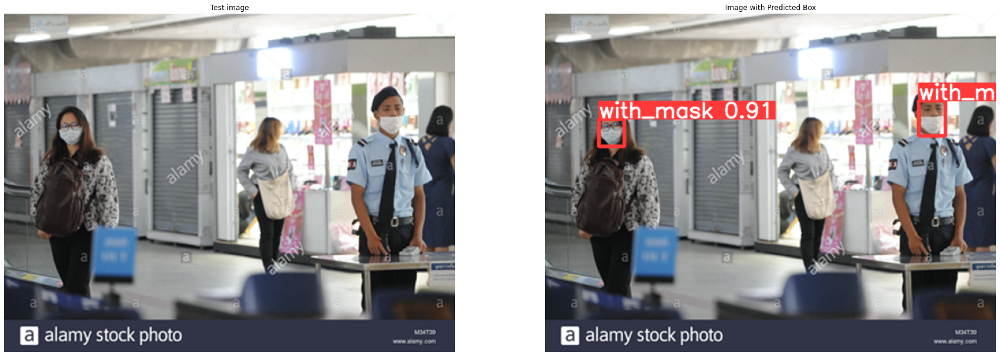

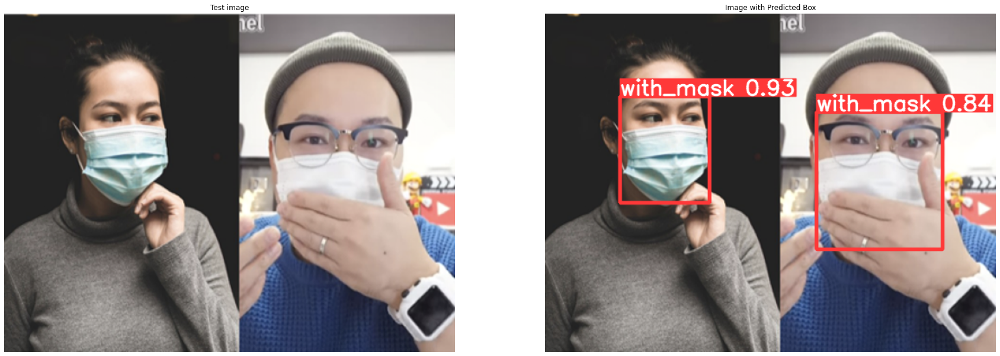

...

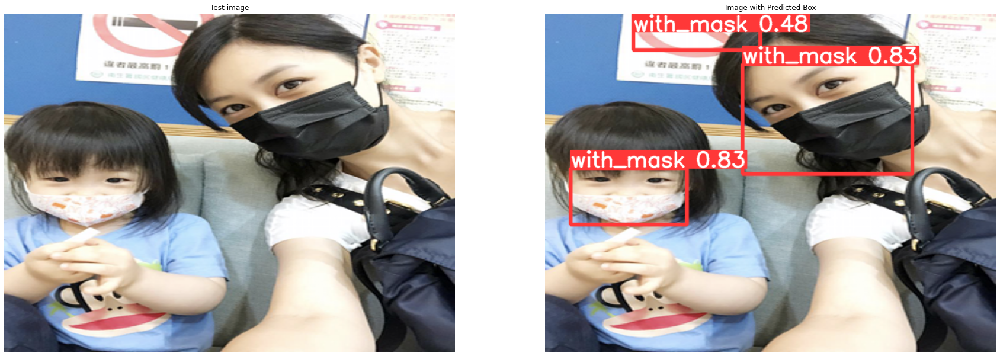

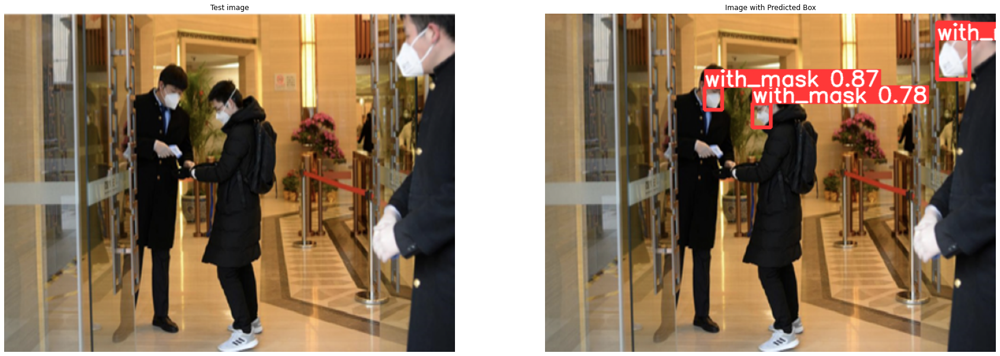

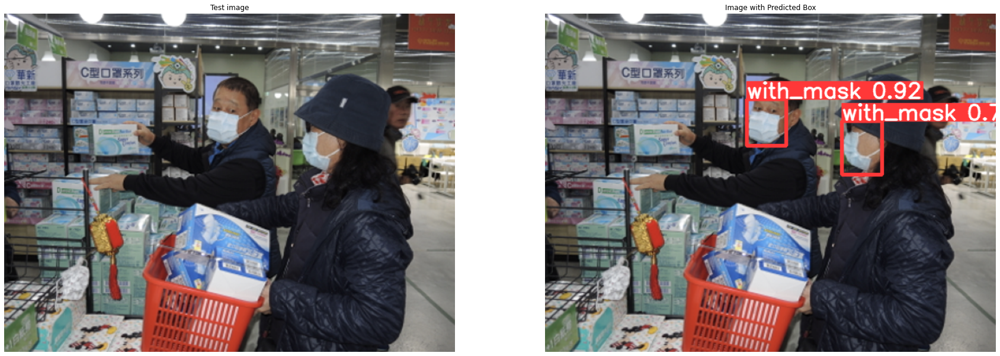

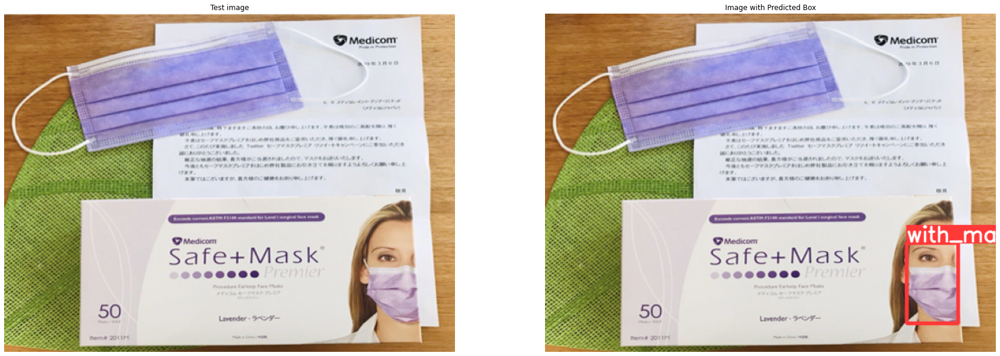

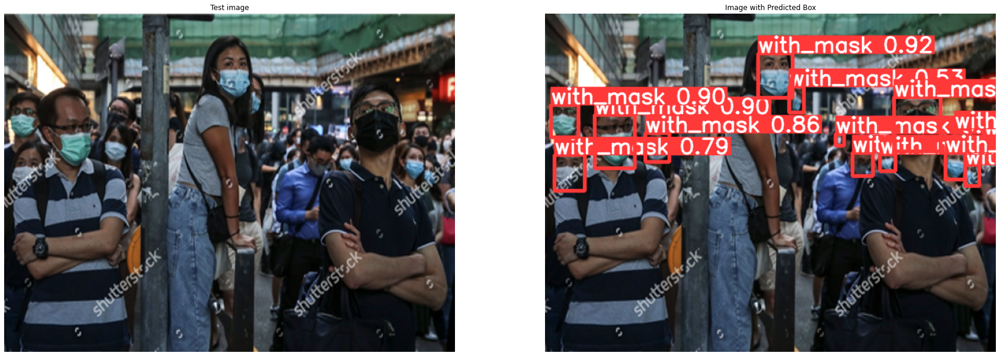

In [47]:
# Checking the results to see how our model performed
for i in os.listdir("/kaggle/working/yolov5/runs/detect/expTestImage"):
    show_image(i) 
    plt.show()

# Sources
[1] https://www.section.io/engineering-education/introduction-to-yolo-algorithm-for-object-detection/ <br>
[2] baeldung.com/cs/yolo-algorithm 


# Appendix - Optimal hyperparameters

In [48]:
with open('/kaggle/working/yolov5/runs/train/yolov5s_results/opt.yaml', mode='r') as file:
    docs = yaml.load_all(file, Loader=yaml.FullLoader)
    
    for doc in docs:
        for k, v in doc.items():
            print(k, "->", v)
    

weights -> yolov5s.pt
cfg -> models/custom_yolov5s.yaml
data -> data/data.yaml
hyp -> {'lr0': 0.01, 'lrf': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'warmup_bias_lr': 0.1, 'box': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0.0, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, 'degrees': 0.0, 'translate': 0.1, 'scale': 0.5, 'shear': 0.0, 'perspective': 0.0, 'flipud': 0.0, 'fliplr': 0.5, 'mosaic': 1.0, 'mixup': 0.0, 'copy_paste': 0.0}
epochs -> 50
batch_size -> 32
imgsz -> 640
rect -> False
resume -> False
nosave -> False
noval -> False
noautoanchor -> False
noplots -> False
evolve -> None
bucket -> 
cache -> ram
image_weights -> False
device -> 
multi_scale -> False
single_cls -> False
optimizer -> SGD
sync_bn -> False
workers -> 8
project -> runs/train
name -> yolov5s_results
exist_ok -> False
quad -> False
cos_lr -> False
label_smoothing -> 0.0
patience -> 100
freeze -> [0]
save_

In [49]:
with open('/kaggle/working/yolov5/runs/train/yolov5s_results/hyp.yaml', mode='r') as file:
    docs = yaml.load_all(file, Loader=yaml.FullLoader)
    
    for doc in docs:
        for k, v in doc.items():
            print(k, "->", v)

lr0 -> 0.01
lrf -> 0.01
momentum -> 0.937
weight_decay -> 0.0005
warmup_epochs -> 3.0
warmup_momentum -> 0.8
warmup_bias_lr -> 0.1
box -> 0.05
cls -> 0.5
cls_pw -> 1.0
obj -> 1.0
obj_pw -> 1.0
iou_t -> 0.2
anchor_t -> 4.0
fl_gamma -> 0.0
hsv_h -> 0.015
hsv_s -> 0.7
hsv_v -> 0.4
degrees -> 0.0
translate -> 0.1
scale -> 0.5
shear -> 0.0
perspective -> 0.0
flipud -> 0.0
fliplr -> 0.5
mosaic -> 1.0
mixup -> 0.0
copy_paste -> 0.0


# Appendix - Model results


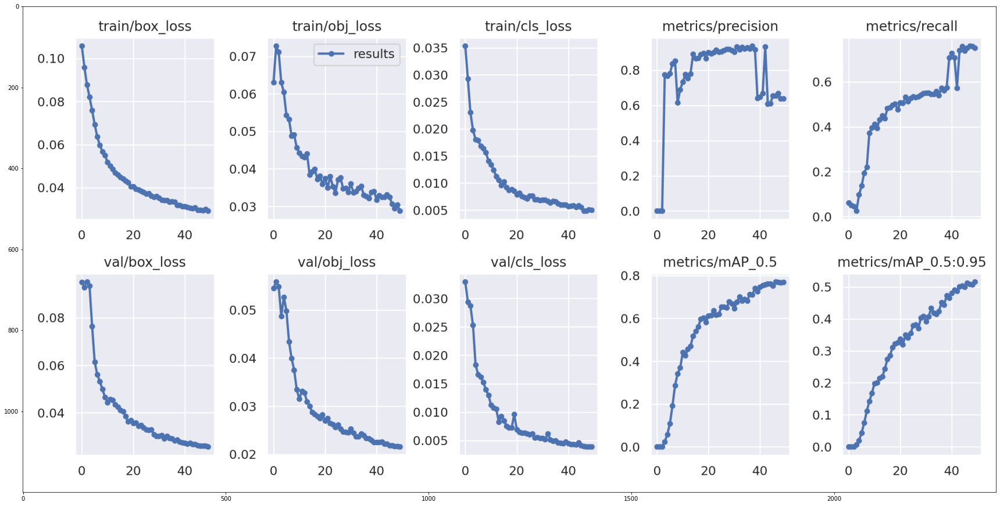

In [50]:
img = plt.imread('/kaggle/working/yolov5/runs/train/yolov5s_results/results.png')
plt.figure(figsize=(30,20))
plt.imshow(img)
plt.show()